# Coursework 2
## Final question

$$
    f(x, y) = \sin\left(\frac{1}{2}x^2 - \frac{1}{4}y ^ 2 + 3\right) \cos(2x + 1 - \exp(y)) 
$$

Optimisation procedures are ubiquitous in machine learning models that depend on the maximisation of a likelihood function.

In [1]:
using Plots
using LaTeXStrings
using ForwardDiff

In [2]:
new = [CartesianIndex()]

1-element Array{CartesianIndex{0},1}:
 CartesianIndex()

In [3]:
function plot_path!(hist)
    plot!(eachcol(hist)..., linewidth=2, color=:red)
    scatter!(hist[begin, [begin]], hist[begin, [end]], color=:red, legend=nothing)
end

function check_convergence(f, X_hist, maxit; rtol=1e-7)
    converge = false
    nits = size(X_hist)[begin]
    if nits <= 2
        return converge
    end
    
    X_end = X_hist[end, :]
    X_begin = X_hist[end-1, :]
    
    f_end = f(X_end...)
    f_begin = f(X_begin...)
    
    if nits >= maxit
        @warn "Procedure did not converge"
        converge = true
    elseif f_end == f_begin
        @warn "No change observed"
        converge = true
    elseif abs(f_end / f_begin - 1) <= rtol
        converge = true
    end
    
    return converge
end

check_convergence (generic function with 1 method)

In [30]:
function f(x, y)
    sin(x ^ 2 / 2 - y ^ 2 /  4 + 3) * cos(2x + 1 - exp(y))
end

∇f = X -> ForwardDiff.gradient(X -> f(X[1], X[2]), X);

In [140]:
xrange = -4:0.01:4
yrange = -5:0.01:2
Z = map(X -> f(X[2], X[1]), Base.product(yrange, xrange));

## Plain gradient descent

In [141]:
nits = 5_000
X0 = [1, -0.5]
X0 = [0, 0]
X_hist = zeros(nits, 2)
X_hist[begin, :] = X0;

In [142]:
X0 = [0., 0.]
X_hist = X0[new, :]

maxit = 100
α = 0.5


convergence = false
while !convergence
    X0 -= α * ∇f(X0)
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

┌ Warning: No change observed
└ @ Main In[3]:23


In [143]:
f(X_hist[end, :]...)

0.1411200080598672

In [146]:
nsteps = 3
skip = Int(floor(length(X_hist[:, begin]) / nsteps))

contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

## Momentum optimisation

In [251]:
X0 = [0, 0]
X_hist = X0[new, :]
maxit = 200
α = 0.05
# Play with 0.7, 0.8, 0.81
β = 0.8


convergence = false
m = ones(2)
while !convergence
    m = β * m + α * ∇f(X0)
    X0 = X0 - m
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

In [252]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

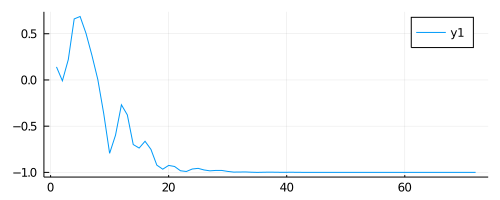

In [254]:
plot(map(X -> f(X[1], X[2]), eachrow(X_hist)), size=(500, 200))

In [255]:
f(X_hist[end, :]...)

-0.9999998844353907

## Nesterov Accelerated Gradient

NAG modifies the momentum optimizer by evaluating the gradient of the function slightly ahead towards the direction of the momentum

In [247]:
X0 = [0, 0]
X_hist = X0[new, :]
maxit = 500
# Play with 0.01, 0.05
α = 0.05
# Play with 0.7, 0.8, 0.81
β = 0.8


convergence = false
m = ones(2)
while !convergence
    m = β * m + α * ∇f(X0 + β * m)
    X0 = X0 - m
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

┌ Warning: Procedure did not converge
└ @ Main In[3]:20


In [248]:
f(X_hist[end, :]...)

-0.964870873405477

In [249]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

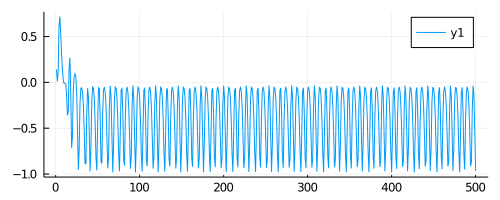

In [250]:
plot(map(X -> f(X[1], X[2]), eachrow(X_hist)), size=(500, 200))

## AdaGrad

$$
s := s + \nabla f(x) \odot \nabla f(x)\\
    x := x - \alpha \nabla f(x) \oslash \sqrt{s + \epsilon}
$$

In [243]:
X0 = [0, -0.1]
X_hist = X0[new, :]
maxit = 500
# Play with 0.01, 0.05
α = 0.05
ϵ = 1e-6

convergence = false
s = ones(2)
while !convergence
    s = s + ∇f(X0) .* ∇f(X0)
    X0 = X0 - α * ∇f(X0) ./ sqrt.(s .+ ϵ)
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

┌ Warning: Procedure did not converge
└ @ Main In[3]:20


In [244]:
f(X_hist[end, :]...)

-0.8832772185159766

In [245]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

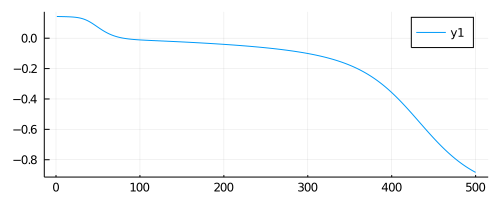

In [246]:
plot(map(X -> f(X[1], X[2]), eachrow(X_hist)), size=(500, 200))

## RMSProp

$$
s := \beta s + (1 - \beta) \nabla f(x) \odot \nabla f(x)\\
    x := x - \alpha \nabla f(x) \oslash \sqrt{s + \epsilon}
$$

In [236]:
X0 = [0, 0]
X0 = [0, -0.1]
X_hist = X0[new, :]
maxit = 500
# Play with 0.01, 0.05
α = 0.01
β = 0.3
ϵ = 1e-8

convergence = false
s = ones(2)
while !convergence
    s = β * s + (1 - β) * ∇f(X0) .* ∇f(X0)
    X0 = X0 - α * ∇f(X0) ./ sqrt.(s .+ ϵ)
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

┌ Warning: Procedure did not converge
└ @ Main In[3]:20


In [237]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

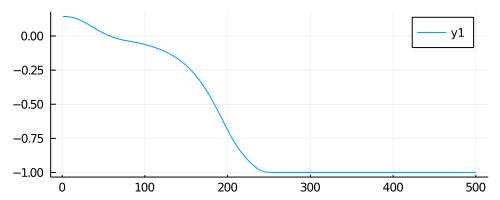

In [242]:
plot(map(X -> f(X[1], X[2]), eachrow(X_hist)), size=(500, 200))

## ADAM

$$
m := \beta_1 m + (1 - \beta_1) \nabla f(x)\\
s := \beta_2 s + (1 - \beta_2) \nabla f(x) \odot \nabla f(x)\\
$$

$$
\hat m := \frac{m}{1 - \beta_1^t} \\
    \hat s := \frac{s}{1 - \beta_2^t}
$$


$$
x := x - \alpha \hat m \oslash \sqrt{\hat s + \epsilon}
$$

In [312]:
X0 = [0, 0]
X_hist = X0[new, :]
maxit = 500
# Play with 0.01, 0.05
α = 0.03
β1 = 0.8
β2 = 0.35
ϵ = 1e-8

convergence = false
s = ones(2) * 0
m = ones(2)
while !convergence
    m = β1 * m + (1 - β1) * ∇f(X0)
    s = β2 * s + (1 - β2) * ∇f(X0) .* ∇f(X0)
    
    mhat = m / (1 - β1)
    shat = s / (1 - β2)
    
    X0 = X0 - α * mhat ./ sqrt.(shat .+ ϵ)
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

┌ Warning: Procedure did not converge
└ @ Main In[3]:20


In [313]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)